<a href="https://colab.research.google.com/github/jpan0829/MultipleObjectTracking/blob/main/MultipleObjectTracking.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

###Jeff Pan
NetId: jp4839

###Task 1: Understand the problem and setup environment




*   Detecting moving objects in each frame. Using YOLOv3 for object detection.load the pre-trained configuration and weights, as well as the class names of the COCO dataset on which the Darknet model was trained.Last, displaying it with the bounding boxes around detected objects
*   Tracking the moving objects from frame to frame. In addtion to YOLOv3 detector, applying a Kalman filter to predict the track of previously identified objects, and match them with new detections. Kalman filter works by a two-phase process. For the prediction phase, the Kalman filter produces estimates of the current state variables, along with their uncertainties. During update, these estimates are updated using a weighted average, with more weight being given to estimates with greater certainty.



Downlaod file

In [ ]:
! git clone https://github.com/sseshadr/auvsi-cv-all.git

Down multiobject avi file

### Task 2: Object Detector

In [ ]:
!wget https://pjreddie.com/media/files/yolov3.weights


In [ ]:
!wget https://raw.githubusercontent.com/pjreddie/darknet/master/cfg/yolov3.cfg


In [ ]:
! git clone https://github.com/eriklindernoren/PyTorch-YOLOv3 yolo3

In [ ]:
import numpy as np
import cv2 as cv

In [ ]:
def xyxy2xywh(xyxy):
    """
    Convert bounding box coordinates from (xmin, ymin, xmax, ymax) format to (xmin, ymin, width, height).
    Args:
        xyxy (numpy.ndarray):
    Returns:
        numpy.ndarray: Bounding box coordinates (xmin, ymin, width, height).
    """

    if len(xyxy.shape) == 2:
        w, h = xyxy[:, 2] - xyxy[:, 0] + 1, xyxy[:, 3] - xyxy[:, 1] + 1
        xywh = np.concatenate((xyxy[:, 0:2], w[:, None], h[:, None]), axis=1)
        return xywh.astype("int")
    elif len(xyxy.shape) == 1:
        (left, top, right, bottom) = xyxy
        width = right - left + 1
        height = bottom - top + 1
        return np.array([left, top, width, height]).astype('int')
    else:
        raise ValueError("Input shape not compatible.")

In [ ]:
class Detector:
    """
    Abstract class for detector.
    Args:
        object_names (dict): Dictionary containing (key, value) as (class_id, class_name) for object detector.
        confidence_threshold (float): Confidence threshold for object detection.
        nms_threshold (float): Threshold for non-maximal suppression.
        draw_bboxes (bool): If true, draw bounding boxes on the image is possible.
    """

    def __init__(self, object_names, confidence_threshold, nms_threshold, draw_bboxes=True):
        self.object_names = object_names
        self.confidence_threshold = confidence_threshold
        self.nms_threshold = nms_threshold
        self.height = None
        self.width = None

        np.random.seed(12345)
        if draw_bboxes:
            self.bbox_colors = {key: np.random.randint(0, 255, size=(3,)).tolist() for key in self.object_names.keys()}

    def forward(self, image):
        """
        Forward pass for the detector with input image.
        Args:
            image (numpy.ndarray): Input image.
        Returns:
            numpy.ndarray: detections
        """
        raise NotImplemented

    def detect(self, image):
        """
        Detect objects in the input image.
        Args:
            image (numpy.ndarray): Input image.
        Returns:
            tuple: Tuple containing the following elements:
                - bboxes (numpy.ndarray): Bounding boxes with shape (n, 4) containing detected objects with each row as `(xmin, ymin, width, height)`.
                - confidences (numpy.ndarray): Confidence or detection probabilities if the detected objects with shape (n,).
                - class_ids (numpy.ndarray): Class_ids or label_ids of detected objects with shape (n, 4)
        """
        if self.width is None or self.height is None:
            (self.height, self.width) = image.shape[:2]

        detections = self.forward(image).squeeze(axis=0).squeeze(axis=0)

        bboxes, confidences, class_ids = [], [], []

        for i in range(detections.shape[0]):
            detection = detections[i, :]
            class_id = detection[1]
            confidence = detection[2]

            if confidence > self.confidence_threshold:
                bbox = detection[3:7] * np.array([self.width, self.height, self.width, self.height])
                bboxes.append(bbox.astype("int"))
                confidences.append(float(confidence))
                class_ids.append(int(class_id))

        if len(bboxes):
            bboxes = xyxy2xywh(np.array(bboxes)).tolist()
            class_ids = np.array(class_ids).astype('int')
            indices = cv.dnn.NMSBoxes(bboxes, confidences, self.confidence_threshold, self.nms_threshold).flatten()
            return np.array(bboxes)[indices, :], np.array(confidences)[indices], class_ids[indices]
        else:
            return np.array([]), np.array([]), np.array([])

    def draw_bboxes(self, image, bboxes, confidences, class_ids):
        """
        Draw the bounding boxes about detected objects in the image.
        Args:
            image (numpy.ndarray): Image or video frame.
            bboxes (numpy.ndarray): Bounding boxes pixel coordinates as (xmin, ymin, width, height)
            confidences (numpy.ndarray): Detection confidence or detection probability.
            class_ids (numpy.ndarray): Array containing class ids (aka label ids) of each detected object.
        Returns:
            numpy.ndarray: image with the bounding boxes drawn on it.
        """

        for bb, conf, cid in zip(bboxes, confidences, class_ids):
            clr = [int(c) for c in self.bbox_colors[cid]]
            cv.rectangle(image, (bb[0], bb[1]), (bb[0] + bb[2], bb[1] + bb[3]), clr, 2)
            label = "{}:{:.4f}".format(self.object_names[cid], conf)
            (label_width, label_height), baseLine = cv.getTextSize(label, cv.FONT_HERSHEY_SIMPLEX, 0.5, 2)
            y_label = max(bb[1], label_height)
            cv.rectangle(image, (bb[0], y_label - label_height), (bb[0] + label_width, y_label + baseLine),
                         (255, 255, 255), cv.FILLED)
            cv.putText(image, label, (bb[0], y_label), cv.FONT_HERSHEY_SIMPLEX, 0.5, clr, 2)
        return image


In [ ]:
def load_classes(path):
    """
    Loads class labels at 'path'
    """
    fp = open(path, "r")
    names = fp.read().split("\n")[:-1]
    classes = { i : names[i] for i in range(0, len(names) ) }
    return classes


In [ ]:
class YOLOv3(Detector):
    """
    YOLOv3 Object Detector Module.
    Args:
        weights_path (str): path to network weights file.
        configfile_path (str): path to network configuration file.
        labels_path (str): path to data labels json file.
        confidence_threshold (float): confidence threshold to select the detected object.
        nms_threshold (float): Non-maximum suppression threshold.
        draw_bboxes (bool): If True, assign colors for drawing bounding boxes on the image.
        use_gpu (bool): If True, try to load the model on GPU.
    """

    def __init__(self, weights_path, configfile_path, labels_path, confidence_threshold=0.5, nms_threshold=0.2, draw_bboxes=True, use_gpu=False):
        self.net = cv.dnn.readNetFromDarknet(configfile_path, weights_path)
        object_names = load_classes(labels_path)

        layer_names = self.net.getLayerNames()
        self.layer_names = [layer_names[i[0] - 1] for i in self.net.getUnconnectedOutLayers()]

        self.scale_factor = 1/255.0
        self.image_size = (416, 416)

        self.net = cv.dnn.readNetFromDarknet(configfile_path, weights_path)
        if use_gpu:
            self.net.setPreferableBackend(cv.dnn.DNN_BACKEND_CUDA)
            self.net.setPreferableTarget(cv.dnn.DNN_TARGET_CUDA)

        super().__init__(object_names, confidence_threshold, nms_threshold, draw_bboxes)

    def forward(self, image):
        blob = cv.dnn.blobFromImage(image, self.scale_factor, self.image_size, swapRB=True, crop=False)
        self.net.setInput(blob)
        detections = self.net.forward(self.layer_names)  # detect objects using object detection model
        return detections

    def detect(self, image):
        if self.width is None or self.height is None:
            (self.height, self.width) = image.shape[:2]

        detections = self.forward(image)

        bboxes, confidences, class_ids = [], [], []

        for output in detections:
            for detect in output:
                scores = detect[5:]
                class_id = np.argmax(scores)
                confidence = scores[class_id]
                if confidence > self.confidence_threshold:
                    xmid, ymid, w, h = detect[0:4] * np.array([self.width, self.height, self.width, self.height])
                    x, y = int(xmid - 0.5*w), int(ymid - 0.5*h)
                    bboxes.append([x, y, w, h])
                    confidences.append(float(confidence))
                    class_ids.append(class_id)

        indices = cv.dnn.NMSBoxes(bboxes, confidences, self.confidence_threshold, self.nms_threshold).flatten()
        class_ids = np.array(class_ids).astype('int')
        output = np.array(bboxes)[indices, :].astype('int'), np.array(confidences)[indices], class_ids[indices]
        return output


In [ ]:
VIDEO_FILE = "/content/auvsi-cv-all/objectTracking/examples/ball.mp4"


In [ ]:
WEIGHTS_PATH = (
    '/content/yolov3.weights'
)

In [ ]:
CONFIG_FILE_PATH = '/content/yolov3.cfg'

In [ ]:
LABELS_PATH = "/content/yolo3/data/coco.names"

In [ ]:
CONFIDENCE_THRESHOLD = 0.5
NMS_THRESHOLD = 0.2


In [ ]:
model = YOLOv3(
    weights_path=WEIGHTS_PATH,
    configfile_path=CONFIG_FILE_PATH,
    labels_path=LABELS_PATH,
    confidence_threshold=CONFIDENCE_THRESHOLD,
    nms_threshold=NMS_THRESHOLD,
    draw_bboxes=True,
    use_gpu=False
)


In [ ]:
cap = cv.VideoCapture(VIDEO_FILE)

In [ ]:
from google.colab.patches import cv2_imshow

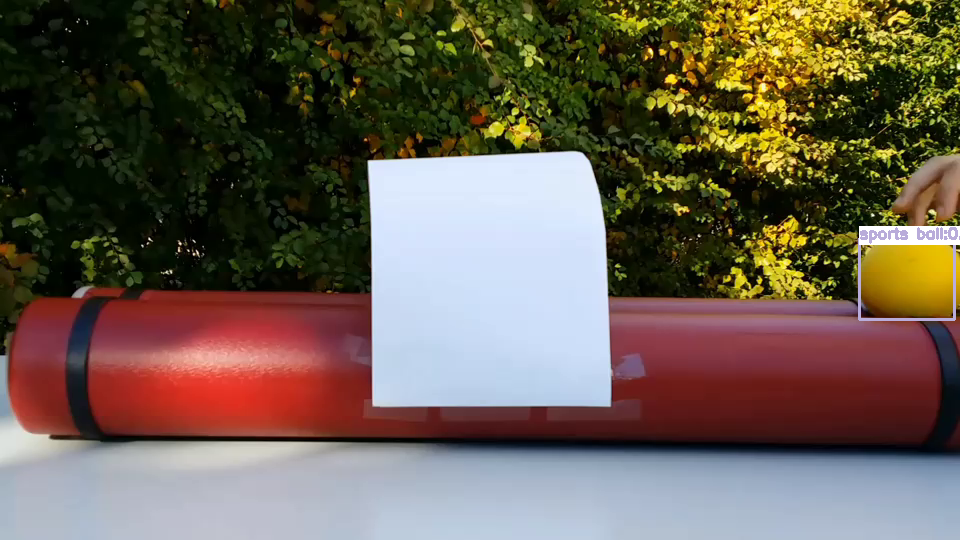

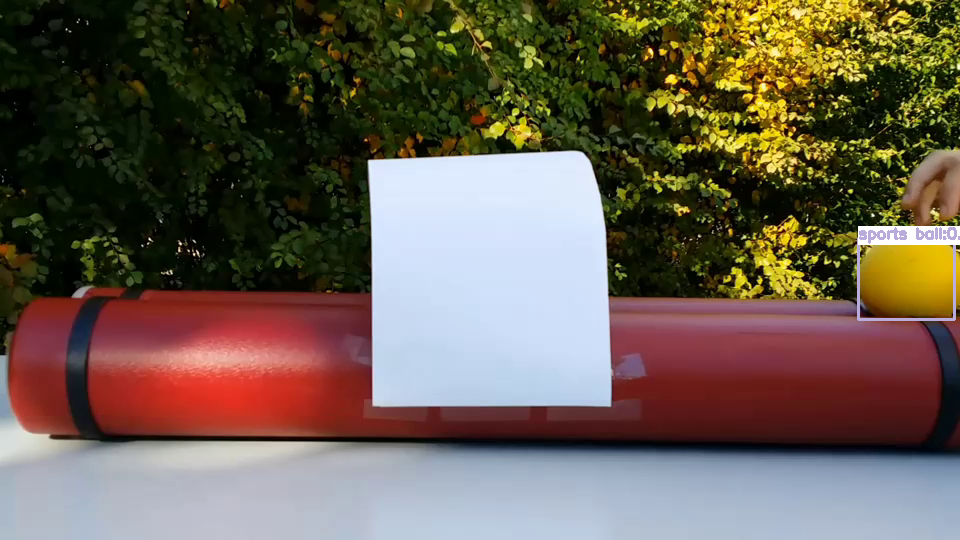

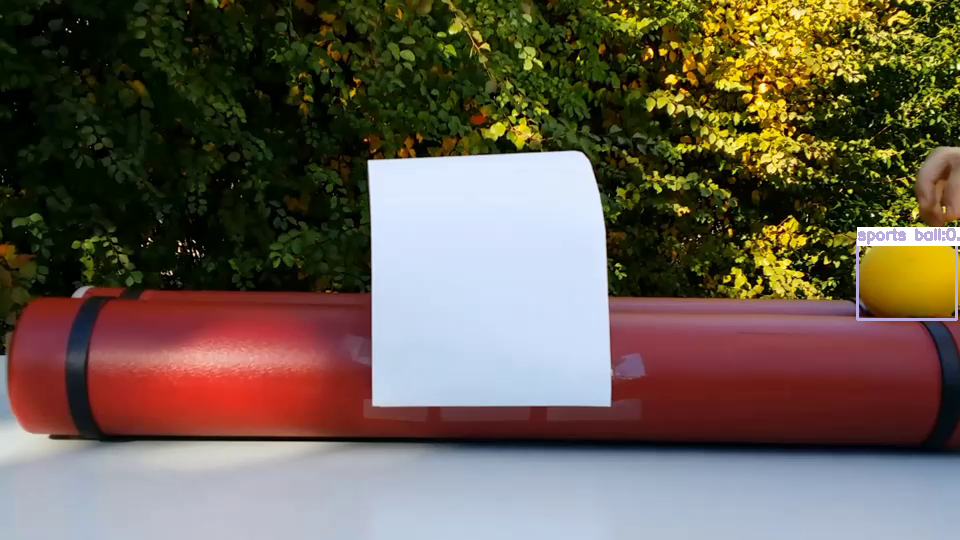

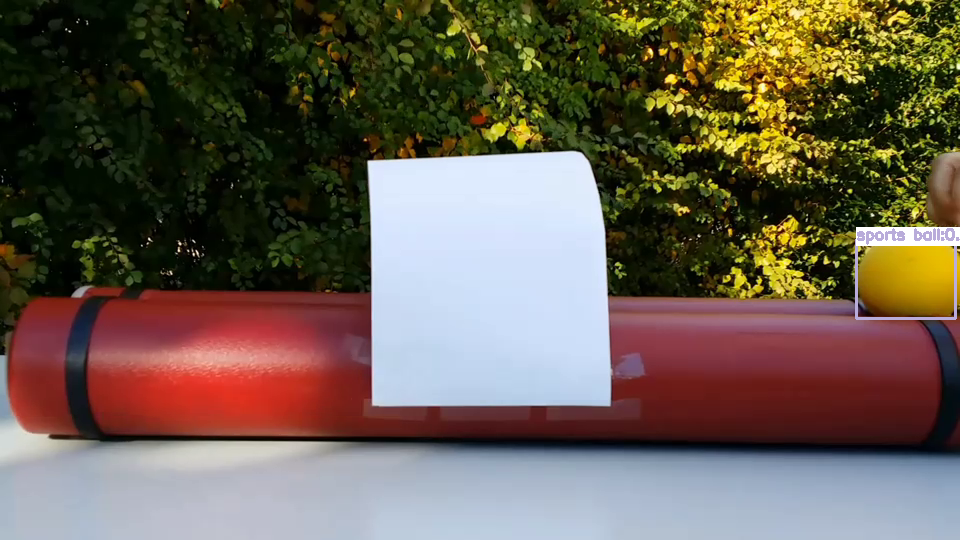

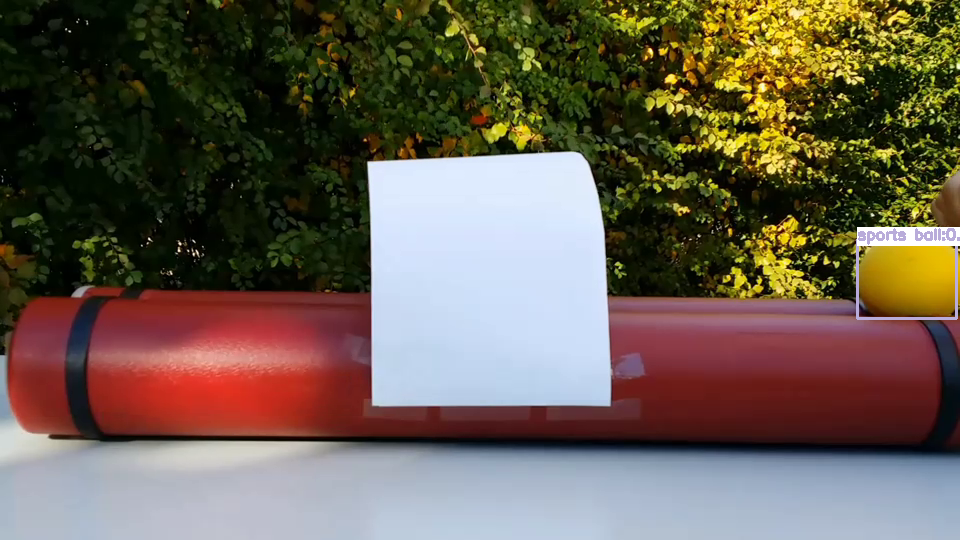

...

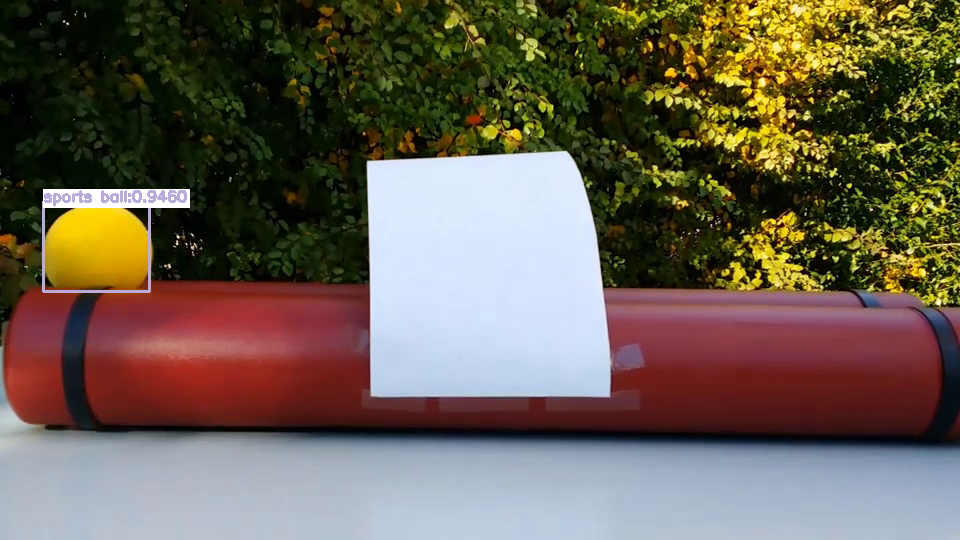

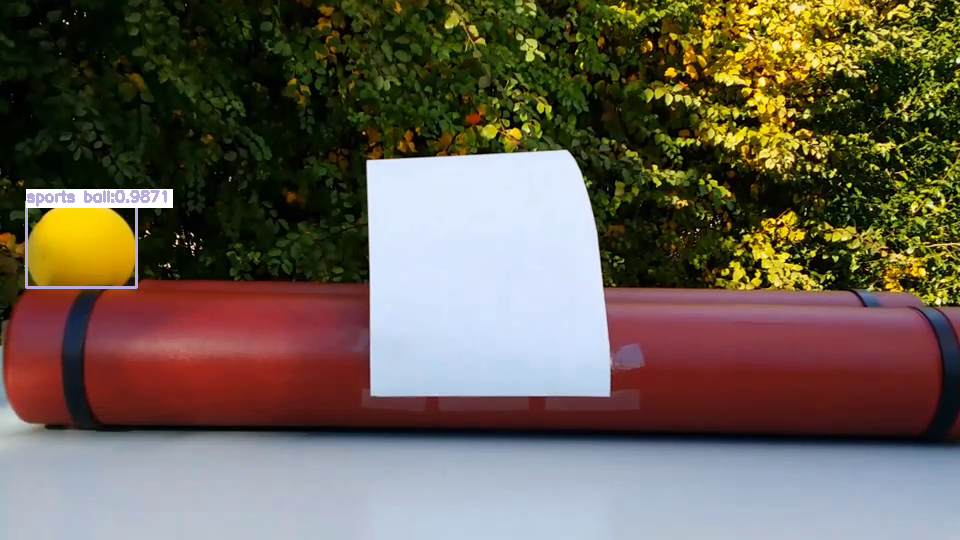

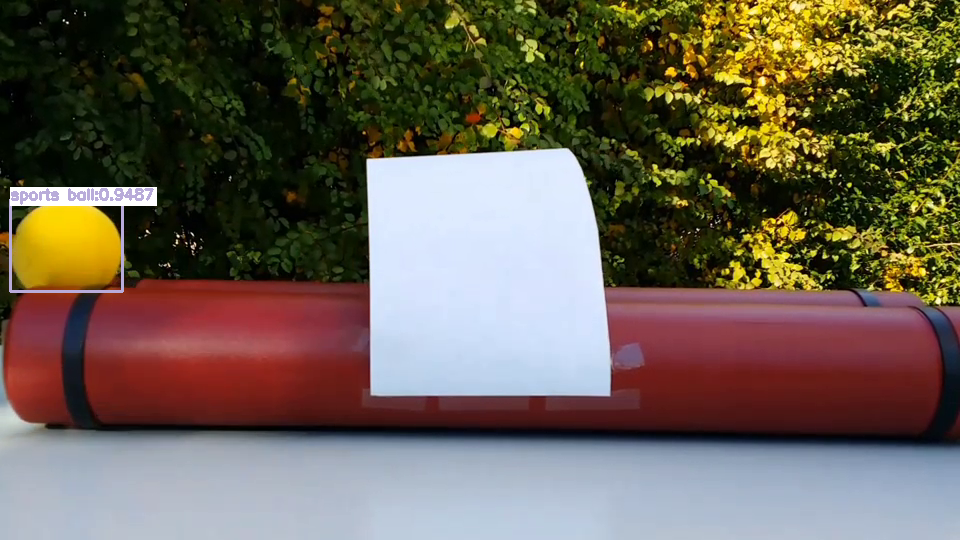

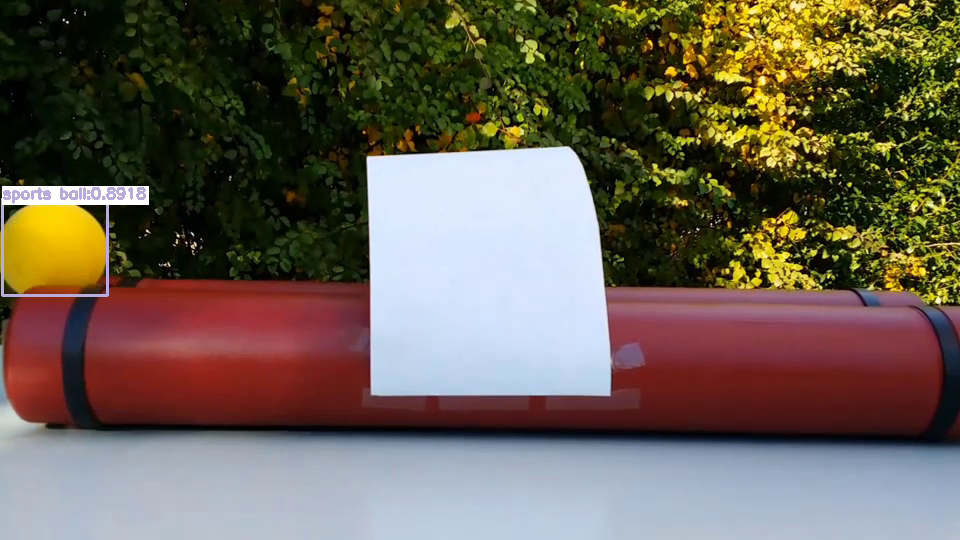

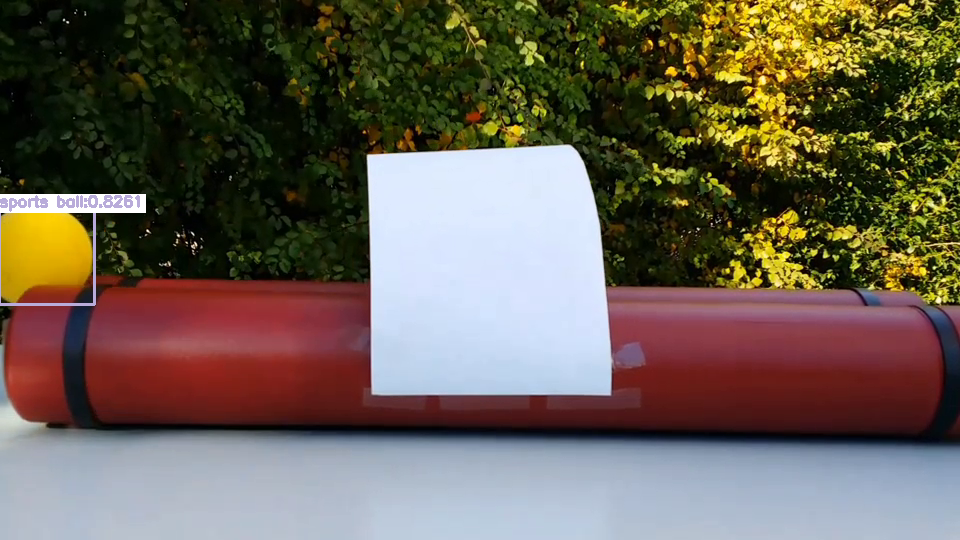

In [ ]:
while True:
    _, image = cap.read()
    if image is None:
        break

    try:
        bboxes, confidences, class_ids = model.detect(image)
        updated_image = model.draw_bboxes(image.copy(), bboxes, confidences, class_ids)
        cv2_imshow(updated_image)
    except:
        continue


### Task 3: Tracker

In [ ]:
class KalmanFilter:
    """
    Kalman Filter Implementation.
    Args:
        transition_matrix (numpy.ndarray): Transition matrix of shape ``(n, n)``.
        measurement_matrix (numpy.ndarray): Measurement matrix of shape ``(m, n)``.
        control_matrix (numpy.ndarray): Control matrix of shape ``(m, n)``.
        process_noise_covariance (numpy.ndarray): Covariance matrix of shape ``(n, n)``.
        measurement_noise_covariance (numpy.ndarray): Covariance matrix of shape ``(m, m)``.
        prediction_covariance (numpy.ndarray): Predicted (a priori) estimate covariance of shape ``(n, n)``.
        initial_state (numpy.ndarray): Initial state of shape ``(n,)``.
    """

    def __init__(
            self,
            transition_matrix,
            measurement_matrix,
            control_matrix=None,
            process_noise_covariance=None,
            measurement_noise_covariance=None,
            prediction_covariance=None,
            initial_state=None
    ):
        self.state_size = transition_matrix.shape[1]
        self.observation_size = measurement_matrix.shape[1]

        self.transition_matrix = transition_matrix
        self.measurement_matrix = measurement_matrix

        self.control_matrix = 0 if control_matrix is None else control_matrix

        self.process_covariance = np.eye(self.state_size) \
            if process_noise_covariance is None else process_noise_covariance

        self.measurement_covariance = np.eye(self.observation_size) \
            if measurement_noise_covariance is None else measurement_noise_covariance

        self.prediction_covariance = np.eye(self.state_size) if prediction_covariance is None else prediction_covariance

        self.x = np.zeros((self.state_size, 1)) if initial_state is None else initial_state

    def predict(self, u=0):
        """
        Prediction step of Kalman Filter.
        Args:
            u (float or int or numpy.ndarray): Control input. Default is `0`.
        Returns:
            numpy.ndarray : State vector of shape `(n,)`.
        """
        self.x = np.dot(self.transition_matrix, self.x) + np.dot(self.control_matrix, u)

        self.prediction_covariance = np.dot(
            np.dot(self.transition_matrix, self.prediction_covariance), self.transition_matrix.T
        ) + self.process_covariance

        return self.x

    def update(self, z):
        """
        Measurement update of Kalman Filter.
        Args:
            z (numpy.ndarray): Measurement vector of the system with shape ``(m,)``.
        """
        y = z - np.dot(self.measurement_matrix, self.x)

        innovation_covariance = np.dot(
            self.measurement_matrix, np.dot(self.prediction_covariance, self.measurement_matrix.T)
        ) + self.measurement_covariance

        optimal_kalman_gain = np.dot(
            np.dot(self.prediction_covariance, self.measurement_matrix.T),
            np.linalg.inv(innovation_covariance)
        )

        self.x = self.x + np.dot(optimal_kalman_gain, y)
        eye = np.eye(self.state_size)
        _t1 = eye - np.dot(optimal_kalman_gain, self.measurement_matrix)
        t1 = np.dot(np.dot(_t1, self.prediction_covariance), _t1.T)
        t2 = np.dot(np.dot(optimal_kalman_gain, self.measurement_covariance), optimal_kalman_gain.T)
        self.prediction_covariance = t1 + t2


In [ ]:
def draw_tracks(image, tracks):
    """
    Draw on input image.
    Args:
        image (numpy.ndarray): image
        tracks (list): list of tracks to be drawn on the image.
    Returns:
        numpy.ndarray: image with the track-ids drawn on it.
    """

    for trk in tracks:

        trk_id = trk[1]
        xmin = trk[2]
        ymin = trk[3]
        width = trk[4]
        height = trk[5]

        xcentroid, ycentroid = int(xmin + 0.5*width), int(ymin + 0.5*height)

        text = "ID {}".format(trk_id)

        cv.putText(image, text, (xcentroid - 10, ycentroid - 10), cv.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
        cv.circle(image, (xcentroid, ycentroid), 4, (0, 255, 0), -1)

    return image


In [ ]:
model2 = YOLOv3(
    weights_path=WEIGHTS_PATH,
    configfile_path=CONFIG_FILE_PATH,
    labels_path=LABELS_PATH,
    confidence_threshold=CONFIDENCE_THRESHOLD,
    nms_threshold=NMS_THRESHOLD,
    draw_bboxes=True,
    use_gpu=False
)


In [ ]:
cap2 = cv.VideoCapture(VIDEO_FILE)


In [ ]:
_, image2 = cap2.read()

In [ ]:
while True:
    _, image2 = cap2.read()
    if image2 is None:
        break
    try:
        image2 = cv.resize(image2, (700, 500))

        bboxes, confidences, class_ids = model2.detect(image2)

        tracks = KalmanFilter.update(bboxes, confidences, class_ids)

        updated_image2 = model2.draw_bboxes(image2.copy(), bboxes, confidences, class_ids)

        updated_image2 = draw_tracks(updated_image2, tracks)

        cv2_imshow(updated_image2)

    except:
        continue
